# Analisis exploratorio de Datos

Notebook basado y modificado del original de [Madhan Chandrasekharan](https://www.kaggle.com/gcmadhan/covid-vaccine-eda-visualization)

## Importación de módulos 

In [1]:
# import numpy as np # linear algebra
import pandas as pd

## Carga de datos 

In [2]:
df = pd.read_csv('country_vaccinations.csv')

## Exploración 

In [3]:
df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/


In [4]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21628 entries, 0 to 21627
Data columns (total 15 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   country                              21628 non-null  object 
 1   iso_code                             21628 non-null  object 
 2   date                                 21628 non-null  object 
 3   total_vaccinations                   12275 non-null  float64
 4   people_vaccinated                    11479 non-null  float64
 5   people_fully_vaccinated              8967 non-null   float64
 6   daily_vaccinations_raw               10187 non-null  float64
 7   daily_vaccinations                   21412 non-null  float64
 8   total_vaccinations_per_hundred       12275 non-null  float64
 9   people_vaccinated_per_hundred        11479 non-null  float64
 10  people_fully_vaccinated_per_hundred  8967 non-null   float64
 11  daily_vaccinations_per_milli

In [5]:
# El campo 'date' se cargó como type:object, y lo convertimos a type:date, para poder trabajarlo como una fecha.
df['date']=pd.to_datetime(df['date'])

In [6]:
type(df['date'][0])

pandas._libs.tslibs.timestamps.Timestamp

In [7]:
# Listamos las variables y los valores nulos de cada uno.
df.isna().sum()

country                                    0
iso_code                                   0
date                                       0
total_vaccinations                      9353
people_vaccinated                      10149
people_fully_vaccinated                12661
daily_vaccinations_raw                 11441
daily_vaccinations                       216
total_vaccinations_per_hundred          9353
people_vaccinated_per_hundred          10149
people_fully_vaccinated_per_hundred    12661
daily_vaccinations_per_million           216
vaccines                                   0
source_name                                0
source_website                             0
dtype: int64

In [8]:
# "Forma" del dataframe
df.shape

(21628, 15)

In [9]:
#Listado por vacunas y registros
df['vaccines'].value_counts()

Oxford/AstraZeneca                                                                    3774
Johnson&Johnson, Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                         3036
Moderna, Oxford/AstraZeneca, Pfizer/BioNTech                                          1687
Oxford/AstraZeneca, Pfizer/BioNTech                                                   1620
Moderna, Pfizer/BioNTech                                                              1276
Pfizer/BioNTech                                                                       1240
Oxford/AstraZeneca, Sinopharm/Beijing                                                 1086
Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac                                          1054
Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing, Sputnik V                      927
Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm/Beijing                                 416
Oxford/AstraZeneca, Sinopharm/Beijing, Sputnik V                                       404

In [10]:
# Listado de paises y registros
df['country'].value_counts()

Norway                             180
Scotland                           172
Canada                             169
Russia                             168
China                              168
                                  ... 
Turkmenistan                         1
Tuvalu                               1
Bonaire Sint Eustatius and Saba      1
Cook Islands                         1
Guinea-Bissau                        1
Name: country, Length: 214, dtype: int64

In [11]:
# La variable 'country' no tiene valores nulos
df['country'].isna().sum()

0

## Análisis gráfico

In [12]:
# Importamos los paquetes para poder graficas
import plotly.express as px
import plotly.graph_objects as go

In [13]:
df.columns

Index(['country', 'iso_code', 'date', 'total_vaccinations',
       'people_vaccinated', 'people_fully_vaccinated',
       'daily_vaccinations_raw', 'daily_vaccinations',
       'total_vaccinations_per_hundred', 'people_vaccinated_per_hundred',
       'people_fully_vaccinated_per_hundred', 'daily_vaccinations_per_million',
       'vaccines', 'source_name', 'source_website'],
      dtype='object')

###  Grafico I. Personas con el proceso de vacunación finalizado por país

In [14]:
data1=df.groupby(by=['country']).sum().reset_index()

In [15]:
fig = px.bar(data1.sort_values(by=['people_fully_vaccinated_per_hundred'],
                         ascending=False).reset_index(),
       x='country',
       y='people_fully_vaccinated_per_hundred',
       title='People Vaccinated by country per hundered',
       color='country')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [16]:
data1.head()

,country,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,Afghanistan,3831799.0,3256958.0,574841.0,2859.0,594456.0,9.85,8.36,1.48,15285.0
1,Albania,24787760.0,6990919.0,3550624.0,552252.0,760906.0,861.34,242.91,123.37,264395.0
2,Algeria,75030.0,0.0,0.0,30.0,69070.0,0.17,0.00,0.00,1568.0
3,Andorra,249370.0,156305.0,31652.0,4802.0,31649.0,322.74,202.31,40.98,409618.0
4,Angola,5386560.0,4717488.0,669072.0,0.0,880797.0,16.39,14.35,2.04,26808.0


### Gráfico II - Vacunas por laboratorio

In [17]:
data2=df.groupby(by=['vaccines','country']).sum().reset_index()

In [18]:
data2

,vaccines,country,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million
0,"Abdala, Soberana02",Cuba,7.972472e+06,7972472.0,0.0,196123.0,1014453.0,70.41,70.41,0.00,89565.0
1,"CanSino, Oxford/AstraZeneca, Pfizer/BioNTech, ...",Mexico,1.181931e+09,842814629.0,386252432.0,25950934.0,29449845.0,916.66,653.69,299.60,228412.0
2,"CanSino, Oxford/AstraZeneca, Sinopharm/Beijing...",Pakistan,4.492630e+07,28806863.0,7066652.0,562254.0,5474665.0,20.33,13.02,3.20,24782.0
3,"CanSino, Sinopharm/Beijing, Sinopharm/Wuhan, S...",China,2.018469e+10,0.0,0.0,581008000.0,602262785.0,1402.38,0.00,0.00,418426.0
4,"Covaxin, Oxford/AstraZeneca",Central African Republic,1.907500e+04,18358.0,717.0,0.0,17746.0,0.39,0.38,0.01,3667.0
...,...,...,...,...,...,...,...,...,...,...,...
209,"Sinopharm/Beijing, Sputnik V",Kyrgyzstan,1.286790e+05,67710.0,6868.0,205.0,49622.0,1.97,1.03,0.10,7608.0
210,"Sinopharm/Beijing, Sputnik V",Laos,9.145011e+06,7457983.0,1687028.0,135127.0,768444.0,125.69,102.49,23.19,105621.0
211,Sputnik V,Algeria,7.503000e+04,0.0,0.0,30.0,69070.0,0.17,0.00,0.00,1568.0
212,Sputnik V,Guinea,5.131054e+06,4275131.0,1505375.0,102088.0,246319.0,39.08,32.55,11.46,18756.0


In [19]:
fig = go.Figure()
fig= px.bar(data2.sort_values(by=['people_fully_vaccinated_per_hundred'],
                         ascending=False).reset_index(),
       x='vaccines',
       y='people_fully_vaccinated_per_hundred',
       title='Vaccines taken by company',
       color='vaccines',
       hover_name='country')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico III - Evolución de las personas vacunadas por país 

In [20]:
df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/


In [21]:
fig = px.line(df,
        y='people_vaccinated',
        x=df['date'],
#         color='country',
        title='No of people Vaccinated by Country')

fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [22]:
fig = px.line(df,
        y='people_fully_vaccinated',
        x=df['date'],
        color='country',
        title='No of people fully Vaccinated by Country')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

In [23]:
df.head()

,country,iso_code,date,total_vaccinations,people_vaccinated,people_fully_vaccinated,daily_vaccinations_raw,daily_vaccinations,total_vaccinations_per_hundred,people_vaccinated_per_hundred,people_fully_vaccinated_per_hundred,daily_vaccinations_per_million,vaccines,source_name,source_website
0,Afghanistan,AFG,2021-02-22,0.0,0.0,NaN,NaN,NaN,0.0,0.0,NaN,NaN,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
1,Afghanistan,AFG,2021-02-23,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
2,Afghanistan,AFG,2021-02-24,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
3,Afghanistan,AFG,2021-02-25,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/
4,Afghanistan,AFG,2021-02-26,NaN,NaN,NaN,NaN,1367.0,NaN,NaN,NaN,35.0,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",World Health Organization,https://covid19.who.int/


In [24]:
data = df[[
    'country', 'total_vaccinations', 'people_vaccinated',
    'people_fully_vaccinated', 'vaccines', 'iso_code'
]].groupby(by=['country', 'iso_code', 'vaccines']).sum().reset_index()

In [25]:
data

,country,iso_code,vaccines,total_vaccinations,people_vaccinated,people_fully_vaccinated
0,Afghanistan,AFG,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinopharm...",3831799.0,3256958.0,574841.0
1,Albania,ALB,"Oxford/AstraZeneca, Pfizer/BioNTech, Sinovac, ...",24787760.0,6990919.0,3550624.0
2,Algeria,DZA,Sputnik V,75030.0,0.0,0.0
3,Andorra,AND,"Oxford/AstraZeneca, Pfizer/BioNTech",249370.0,156305.0,31652.0
4,Angola,AGO,Oxford/AstraZeneca,5386560.0,4717488.0,669072.0
...,...,...,...,...,...,...
209,Wales,OWID_WLS,"Moderna, Oxford/AstraZeneca, Pfizer/BioNTech",223488730.0,169554443.0,53934287.0
210,Wallis and Futuna,WLF,Oxford/AstraZeneca,49977.0,37728.0,12249.0
211,Yemen,YEM,Oxford/AstraZeneca,122625.0,122625.0,0.0
212,Zambia,ZMB,"Oxford/AstraZeneca, Sinopharm/Beijing",2484910.0,2443821.0,41089.0


### Grafico IV - Total de dosis y personas vacunadas, por país,

In [26]:
fig = px.scatter(data,
           x='total_vaccinations',
           y='people_vaccinated',
           color='country',
           size='people_vaccinated')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico V - Personas vacunadas por país

In [27]:
fig = px.scatter_geo(data,
               locations='iso_code',
               size='people_vaccinated',
               color='vaccines',
               title='Country by People Vaccinated')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

### Gráfico VI - Personas con el proceso de vacunación completo por país, por vacuna

In [28]:
fig = px.scatter_geo(data,
               locations='iso_code',
               size='people_fully_vaccinated',
               color='vaccines',
               title='Country by People fully Vaccinated')
fig.update_layout(
    font_family="Roboto",
)
fig.show()

## Modulos EDA

###  Pandas Profiling

In [29]:
from pandas_profiling import ProfileReport

In [30]:
profile = ProfileReport(df, title="COVID Vaccines")

In [31]:
profile.to_widgets()

### Sweetviz 

In [32]:
import sweetviz as sv
my_report = sv.analyze(df)


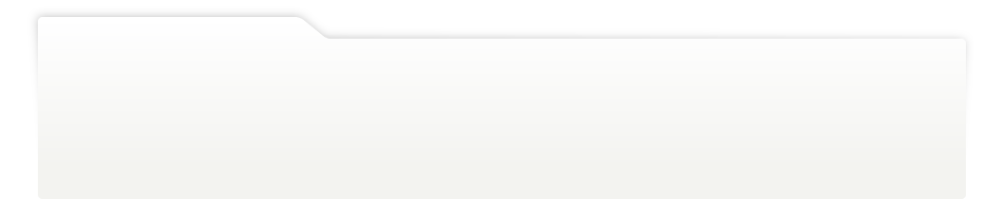
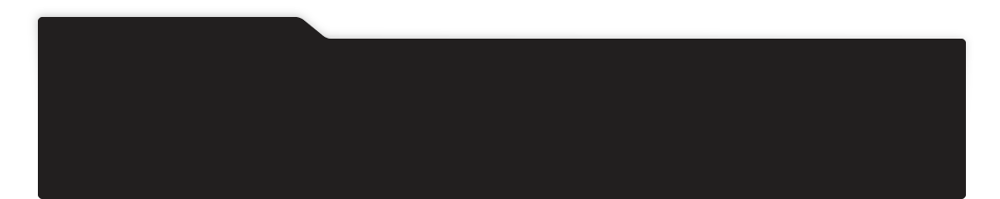
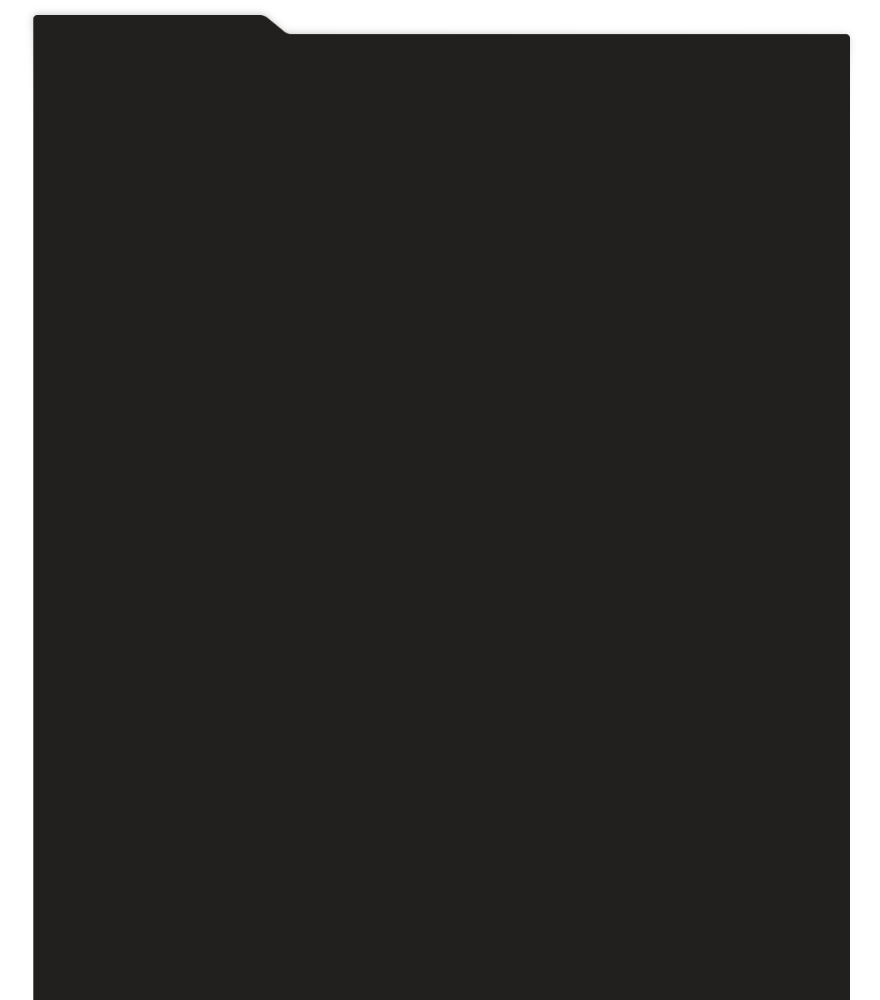
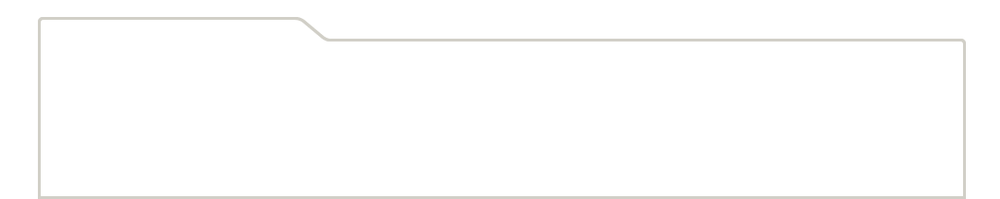
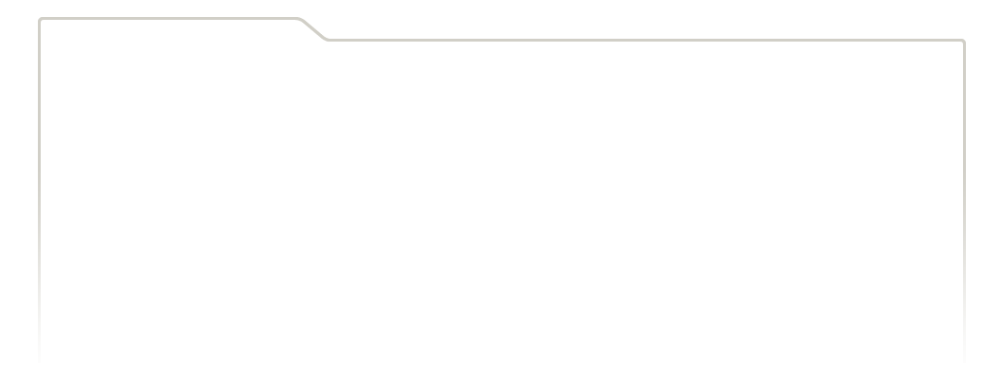
...
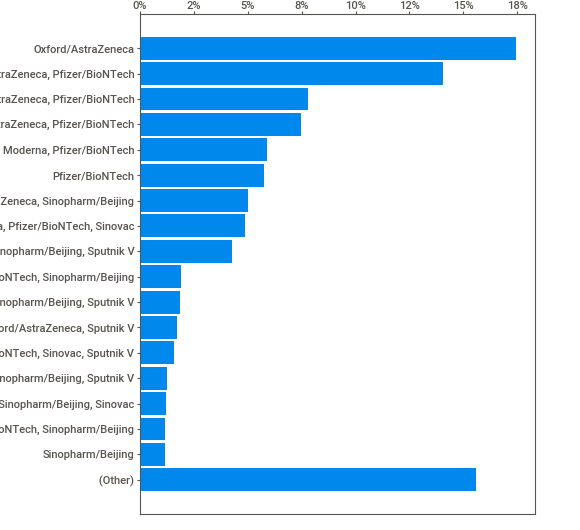
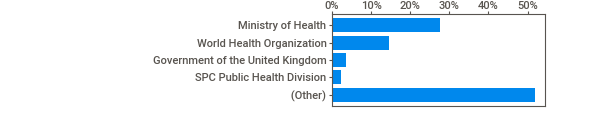
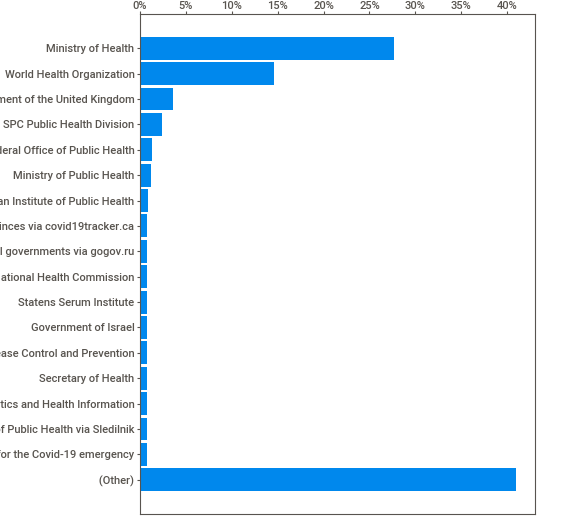
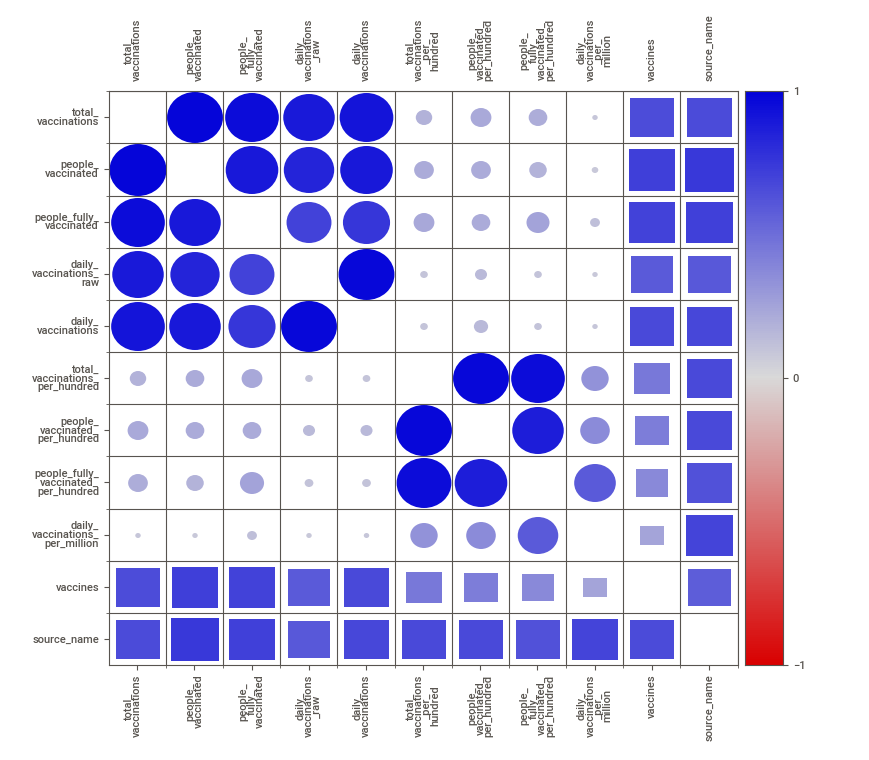
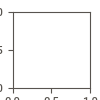

In [33]:
# my_report.show_html()
my_report.show_notebook()# Default arguments will generate to "SWEETVIZ_REPORT.html"

# Exportación 

In [29]:
%%javascript
IPython.notebook.kernel.execute('nb_name = "' + IPython.notebook.notebook_name + '"')

<IPython.core.display.Javascript object>

In [30]:
!jupyter nbconvert --TagRemovePreprocessor.enabled=True --to html $nb_name 

[NbConvertApp] Converting notebook covid-vaccine-eda-visualization.ipynb to html
[NbConvertApp] Writing 26409198 bytes to covid-vaccine-eda-visualization.html


In [31]:
!jupyter nbconvert --TagRemovePreprocessor.enabled=True --TagRemovePreprocessor.remove_cell_tags='{"no"}' --no-input --to html $nb_name 

[NbConvertApp] Converting notebook covid-vaccine-eda-visualization.ipynb to html
[NbConvertApp] Writing 24658219 bytes to covid-vaccine-eda-visualization.html
